
<div style="text-align: center; line-height: 0; padding-top: 9px;">
  <img src="https://databricks.com/wp-content/uploads/2018/03/db-academy-rgb-1200px.png" alt="Databricks Learning">
</div>



# Managing and Exploring Data

The ability to efficiently handle and explore data is paramount for machine learning projects. In this demo, we'll delve into techniques such as reading from and writing to Delta tables, computing statistics for machine learning insights, and visually exploring data for a comprehensive understanding of your datasets.

**Learning Objectives:**

By the end of this demo, you will be able to:

* Read data from a Delta table into a pandas DataFrame.
* Read a previous version of data from a Delta table.
* Write data from a DataFrame into a Delta table.
* Compute summary statistics on data for machine learning using data profiles.
* Compute a correlation matrix for columns/features in machine learning data.
* Visually explore data using built-in visualization capabilities to examine outliers, continuous variable distributions, and categorical variable distributions.


## Requirements

Please review the following requirements before starting the lesson:

* To run this notebook, you need to use one of the following Databricks runtime(s): **13.3.x-cpu-ml-scala2.122 13.3.x-scala2.12**


## Classroom Setup

Before starting the demo, run the provided classroom setup script. This script will define configuration variables necessary for the demo. Execute the following cell:

In [0]:
%run ../Includes/Classroom-Setup-01

Note: you may need to restart the kernel using dbutils.library.restartPython() to use updated packages.
Note: you may need to restart the kernel using dbutils.library.restartPython() to use updated packages.


Resetting the learning environment:
| dropping the catalog "labuser8052946_1733722328_52n6_da"...(1 seconds)

Skipping install of existing datasets to "dbfs:/mnt/dbacademy-datasets/data-preparation-for-machine-learning/v01"

Validating the locally installed datasets:
| listing local files...(0 seconds)
| validation completed...(0 seconds total)
Creating & using the catalog "labuser8052946_1733722328_52n6_da"...(2 seconds)

Predefined tables in "labuser8052946_1733722328_52n6_da.default":
| -none-

Predefined paths variables:
| DA.paths.working_dir: dbfs:/mnt/dbacademy-users/labuser8052946_1733722328@vocareum.com/data-preparation-for-machine-learning
| DA.paths.datasets:    dbfs:/mnt/dbacademy-datasets/data-preparation-for-machine-learning/v01

Setup completed (9 seconds)


**Other Conventions:**

Throughout this demo, we'll refer to the object `DA`. This object, provided by Databricks Academy, contains variables such as your username, catalog name, schema name, working directory, and dataset locations. Run the code block below to view these details:

In [0]:
print(f"Username:          {DA.username}")
print(f"Catalog Name:      {DA.catalog_name}")
print(f"Schema Name:       {DA.schema_name}")
print(f"Working Directory: {DA.paths.working_dir}")
print(f"Datasets Location: {DA.paths.datasets}")

Username:          labuser8052946_1733722328@vocareum.com
Catalog Name:      labuser8052946_1733722328_52n6_da
Schema Name:       default
Working Directory: dbfs:/mnt/dbacademy-users/labuser8052946_1733722328@vocareum.com/data-preparation-for-machine-learning
Datasets Location: dbfs:/mnt/dbacademy-datasets/data-preparation-for-machine-learning/v01


## Read Dataset from `.csv` File

In [0]:
# Load dataset with spark
dataset_path = f"{DA.paths.datasets}/telco/telco-customer-churn-missing.csv"

schema_string = """
    customerID string,
    gender string,
    SeniorCitizen double,
    Partner string,
    Dependents string,
    tenure double,
    phoneService string,
    MultipleLines string,
    internetService string,
    OnlineSecurity string,
    OnlineBackup string,
    DeviceProtection string,
    TechSupport string,
    StreamingTV string,
    StreamingMovies string,
    Contract string,
    PaperlessBilling string,
    PaymentMethod string,
    MonthlyCharges double,
    TotalCharges double,
    Churn string
"""

telco_df = spark.read.csv(dataset_path, \
                          header=True,
                          schema=schema_string,
                          multiLine=True,
                          escape='"')

display(telco_df)

customerID,gender,SeniorCitizen,Partner,Dependents,tenure,phoneService,MultipleLines,internetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
7590-VHVEG,null,0.0,Yes,No,1.0,null,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
5575-GNVDE,Male,0.0,No,No,34.0,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.5,No
3668-QPYBK,Male,0.0,No,No,2.0,Yes,No,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
7795-CFOCW,Male,0.0,No,No,45.0,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.3,1840.75,No
9237-HQITU,Female,0.0,No,No,null,null,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,70.7,151.65,Yes
9305-CDSKC,Female,0.0,No,No,8.0,Yes,Yes,Fiber optic,No,No,Yes,No,Yes,Yes,Month-to-month,Yes,Electronic check,99.65,820.5,Yes
1452-KIOVK,Male,0.0,No,Yes,null,Yes,Yes,Fiber optic,No,Yes,No,No,Yes,No,Month-to-month,Yes,Credit card (automatic),89.1,1949.4,No
6713-OKOMC,Female,0.0,No,null,10.0,No,No phone service,DSL,Yes,No,No,No,No,No,Month-to-month,No,Mailed check,29.75,301.9,No
7892-POOKP,null,0.0,Yes,No,28.0,Yes,Yes,Fiber optic,No,No,Yes,Yes,Yes,Yes,Month-to-month,Yes,Electronic check,104.8,3046.05,Yes
6388-TABGU,Male,0.0,No,Yes,62.0,Yes,No,DSL,Yes,Yes,No,No,No,No,One year,No,Bank transfer (automatic),56.15,3487.95,No


## Explore Data with Summary Stats

While using notebooks, you have various options to view summary statistics for dataset. Some of these options are:

* using spark DataFrame's built-in method (e.g. `summary()`)
* using databricks' utility methods (e.g. `dbutils.data.summarize()`)
* using databricks' built-in data profiler/visualizations
* using external libraries such as `matplotlib`


In this section we will go over the Spark's and Databricks' built-in features for summarizing data. In the next section, we will explore the visualization options.


The first and simplest way is using Spark's `summary` function.

In [0]:
# Display summary statistics with spark
display(telco_df.summary())

summary,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,phoneService,MultipleLines,internetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
count,7043,6339,6339,6339,6339,6339,6339,6339,6339,6339,7043,7043,7043,7043,7043,7043,7043,6339,7043,6328,7043
mean,null,null,0.16548351474996056,null,null,32.48367250354946,null,null,null,null,null,null,null,null,null,null,null,null,64.76169246059922,2291.388882743367,null
stddev,null,null,0.3716456781695826,null,null,24.61084000798043,null,null,null,null,null,null,null,null,null,null,null,null,30.090047097678482,2274.2824496052585,null
min,0002-ORFBO,Female,0.0,No,No,0.0,No,No,DSL,No,No,No,No,No,No,Month-to-month,No,Bank transfer (automatic),18.25,18.8,No
25%,null,null,0.0,null,null,9.0,null,null,null,null,null,null,null,null,null,null,null,null,35.5,400.3,null
50%,null,null,0.0,null,null,29.0,null,null,null,null,null,null,null,null,null,null,null,null,70.35,1399.35,null
75%,null,null,0.0,null,null,56.0,null,null,null,null,null,null,null,null,null,null,null,null,89.85,3815.4,null
max,9995-HOTOH,Male,1.0,Yes,Yes,72.0,Yes,Yes,No,Yes,Yes,Yes,Yes,Yes,Yes,Two year,Yes,Mailed check,118.75,8684.8,Yes


Another way of displaying summary statistics is to use Databricks' `summarize` function. The **`summarize`** function automatically generates a comprehensive report for the dataframe. This report encompasses crucial statistics, data types, and the presence of missing values, providing a holistic view of the dataset

Within this generated summary, the interactive features allow us to sort the information by various criteria:

* Feature Order
* Non-Uniformity
* Alphabetical
* Amount Missing/Zero

Furthermore, leveraging the datatype information, we can selectively filter out specific datatypes for in-depth analysis. This functionality enables us to create charts tailored to our analytical preferences, facilitating a deeper understanding of the dataframe and extracting valuable insights.

In [0]:
dbutils.data.summarize(telco_df)

<!DOCTYPE html>


The **`Display`** function not only facilitates the viewing of detailed dataframes but also serves as a powerful tool for visualizing our dataset according to individual preferences. Whether opting for a Pie Chart or a Bar Chart, this functionality allows for a more insightful exploration, uncovering dependencies and patterns within the dataframe features.

In [0]:
display(telco_df)

customerID,gender,SeniorCitizen,Partner,Dependents,tenure,phoneService,MultipleLines,internetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
7590-VHVEG,null,0.0,Yes,No,1.0,null,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
5575-GNVDE,Male,0.0,No,No,34.0,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.5,No
3668-QPYBK,Male,0.0,No,No,2.0,Yes,No,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
7795-CFOCW,Male,0.0,No,No,45.0,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.3,1840.75,No
9237-HQITU,Female,0.0,No,No,null,null,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,70.7,151.65,Yes
9305-CDSKC,Female,0.0,No,No,8.0,Yes,Yes,Fiber optic,No,No,Yes,No,Yes,Yes,Month-to-month,Yes,Electronic check,99.65,820.5,Yes
1452-KIOVK,Male,0.0,No,Yes,null,Yes,Yes,Fiber optic,No,Yes,No,No,Yes,No,Month-to-month,Yes,Credit card (automatic),89.1,1949.4,No
6713-OKOMC,Female,0.0,No,null,10.0,No,No phone service,DSL,Yes,No,No,No,No,No,Month-to-month,No,Mailed check,29.75,301.9,No
7892-POOKP,null,0.0,Yes,No,28.0,Yes,Yes,Fiber optic,No,No,Yes,Yes,Yes,Yes,Month-to-month,Yes,Electronic check,104.8,3046.05,Yes
6388-TABGU,Male,0.0,No,Yes,62.0,Yes,No,DSL,Yes,Yes,No,No,No,No,One year,No,Bank transfer (automatic),56.15,3487.95,No



## Data Visualization

In this section, we will explore two different methods for exploring data with visualization tools. The first option is the Databricks' rich and interactive visualization capabilities. The second option is to use an external library when you need custom visualizations that are not available in Databricks' visualization tools.


### Integrated Visualization

Let's enhance our understanding of the Telco dataset through integrated visualizations. Below are instructions to create key visualizations that reveal patterns, relationships, and distributions in the data.

#### Step-by-Step instructions for creating visualizations using a visualization editor:

**Step 1: Open Visualization Editor:**
  +  Click on the '+' button or choose the 'Visualizations' option to open the visualization editor.

**Step 2: Select Visualization Type:**
  +  In the visualization editor, find the dropdown menu or toolbar that allows you to choose the type of graph or plot you want (e.g., bar chart, scatter plot, line chart).

**Step 3: Choose X and Y Columns:**  
  +  Once you've selected the type of visualization, look for options to choose the 'X' and 'Y' columns.
  +  Select the column you want to represent on the horizontal axis ('X') and the column for the vertical axis ('Y').

**Step 4: Group By (Optional):**  
  +  If you want to group the data by a specific column, look for the 'Group By' option.
  + Choose a column that will define the groups in your visualization.

**Step 5: Customize Axis and Color:**  
  + Depending on the tool, you may have additional customization options.
  + Explore settings for customizing the X-axis and Y-axis labels, color schemes, and other visual attributes.

**Step 6: Add Additional Parameters (Optional):**
  + Depending on the complexity of your data and the visualization tool, you might have additional options like selecting columns for the color, series, or data labels.
  + Customize these parameters based on your visualization requirements.

**Step 7: Preview and Adjust:**
  + Preview the visualization to see how it looks.
  + If necessary, make adjustments to the settings until you achieve the desired visual representation.

**Step 8: Save or Export:**
  + Once satisfied with the visualization, look for options to save or export the visualization.
  + Save it for future reference or export it in a format suitable for presentations or reports.

In [0]:
display(telco_df)

customerID,gender,SeniorCitizen,Partner,Dependents,tenure,phoneService,MultipleLines,internetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
7590-VHVEG,null,0.0,Yes,No,1.0,null,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
5575-GNVDE,Male,0.0,No,No,34.0,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.5,No
3668-QPYBK,Male,0.0,No,No,2.0,Yes,No,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
7795-CFOCW,Male,0.0,No,No,45.0,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.3,1840.75,No
9237-HQITU,Female,0.0,No,No,null,null,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,70.7,151.65,Yes
9305-CDSKC,Female,0.0,No,No,8.0,Yes,Yes,Fiber optic,No,No,Yes,No,Yes,Yes,Month-to-month,Yes,Electronic check,99.65,820.5,Yes
1452-KIOVK,Male,0.0,No,Yes,null,Yes,Yes,Fiber optic,No,Yes,No,No,Yes,No,Month-to-month,Yes,Credit card (automatic),89.1,1949.4,No
6713-OKOMC,Female,0.0,No,null,10.0,No,No phone service,DSL,Yes,No,No,No,No,No,Month-to-month,No,Mailed check,29.75,301.9,No
7892-POOKP,null,0.0,Yes,No,28.0,Yes,Yes,Fiber optic,No,No,Yes,Yes,Yes,Yes,Month-to-month,Yes,Electronic check,104.8,3046.05,Yes
6388-TABGU,Male,0.0,No,Yes,62.0,Yes,No,DSL,Yes,Yes,No,No,No,No,One year,No,Bank transfer (automatic),56.15,3487.95,No


### Exploring Data with Custom Aggregation

Taking a closer look at `PaymentMethod`, let's review the distribution of the data for this column by calculating aggregated counts per payment type.  

In this section, we utilize the **`groupBy`** and **`count`** functions to analyze the distribution of payment methods in the Telco Churn dataset. The `orderBy` clause is applied to present the results in an organized manner, providing insights into the frequency of each payment method within the dataset.

In [0]:
display(telco_df.groupBy("PaymentMethod").count().orderBy("count", ascending=False))

PaymentMethod,count
Electronic check,2139
Mailed check,1470
Credit card (automatic),1366
Bank transfer (automatic),1364
null,704



**Observation: Identifying Payment Method Distribution**

Through the groupBy command on the "`PaymentMethod`" column, we observe the distribution of payment methods within the Telco Churn dataset. The result reveals that **Electronic check** is the most frequently used method, while other methods such as Bank transfer and Credit card (automatic) also exhibit substantial usage. 

Additionally, there are **704 instances with missing payment method** information.


### External Visualization Tools

You can use any external visualization library to create custom visualization In this demo, we will use popular python library `seaborn` and `matplotlib` for creating custom visualizations.

**First, we will convert the DataFrame to Pandas.**

In [0]:
# Convert to pandas dataframe 
telco_pdf = telco_df.toPandas()

In [0]:
display(telco_pdf)

customerID,gender,SeniorCitizen,Partner,Dependents,tenure,phoneService,MultipleLines,internetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
7590-VHVEG,null,0.0,Yes,No,1.0,null,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
5575-GNVDE,Male,0.0,No,No,34.0,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.5,No
3668-QPYBK,Male,0.0,No,No,2.0,Yes,No,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
7795-CFOCW,Male,0.0,No,No,45.0,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.3,1840.75,No
9237-HQITU,Female,0.0,No,No,null,null,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,70.7,151.65,Yes
9305-CDSKC,Female,0.0,No,No,8.0,Yes,Yes,Fiber optic,No,No,Yes,No,Yes,Yes,Month-to-month,Yes,Electronic check,99.65,820.5,Yes
1452-KIOVK,Male,0.0,No,Yes,null,Yes,Yes,Fiber optic,No,Yes,No,No,Yes,No,Month-to-month,Yes,Credit card (automatic),89.1,1949.4,No
6713-OKOMC,Female,0.0,No,null,10.0,No,No phone service,DSL,Yes,No,No,No,No,No,Month-to-month,No,Mailed check,29.75,301.9,No
7892-POOKP,null,0.0,Yes,No,28.0,Yes,Yes,Fiber optic,No,No,Yes,Yes,Yes,Yes,Month-to-month,Yes,Electronic check,104.8,3046.05,Yes
6388-TABGU,Male,0.0,No,Yes,62.0,Yes,No,DSL,Yes,Yes,No,No,No,No,One year,No,Bank transfer (automatic),56.15,3487.95,No



#### 1. Correlation Heatmap

We will import the **`seaborn`** library, to create a correlation heatmap to visually represent the correlation matrix among numerical features. This provides insights into the strength and direction of relationships between variables.

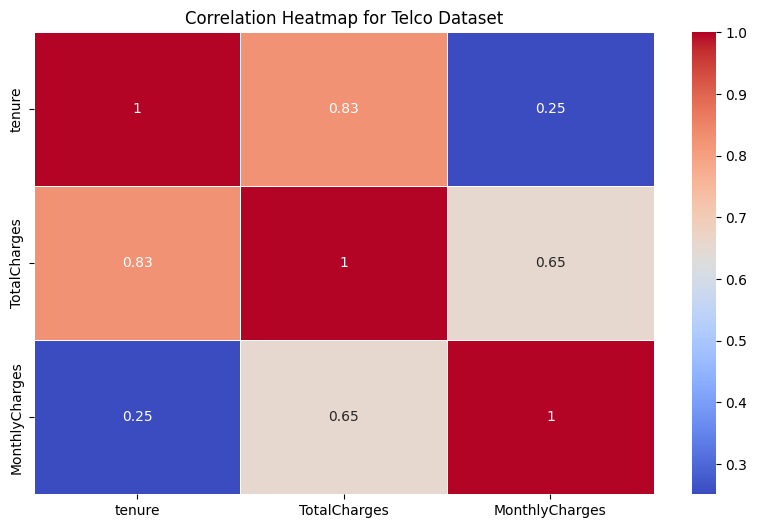

In [0]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


# Select columns that are the numerical columns
selected_columns = ['tenure', 'TotalCharges', 'MonthlyCharges']

# Select the specified columns from the DataFrame
telco_corr = telco_pdf[selected_columns].corr()

# Create a heatmap using seaborn
plt.figure(figsize=(10, 6))
sns.heatmap(telco_corr, annot=True, cmap='coolwarm', linewidths=.5)
plt.title('Correlation Heatmap for Telco Dataset')
plt.show()

#### 2. Pairplot for Numerical Variables:

Generate a pairplot to visualize relationships between **numerical variables**. This provides a quick overview of how features interact and whether certain patterns emerge based on the `'Churn'` status.


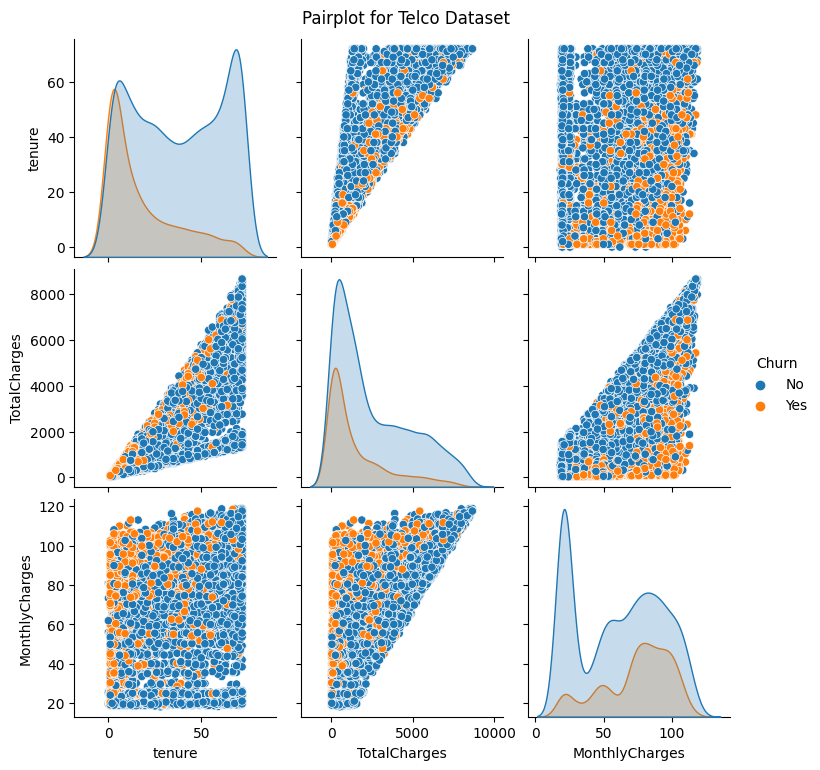

In [0]:
# Select columns that are the numerical columns
selected_columns = ['tenure', 'TotalCharges', 'MonthlyCharges']

# Select the specified columns from the DataFrame
telco_ppdf = telco_pdf[selected_columns + ['Churn']]

# Pairplot for a quick overview of relationships between numerical variables
sns.pairplot(telco_ppdf, hue='Churn', diag_kind='kde')
plt.suptitle('Pairplot for Telco Dataset', y=1.02)
plt.show()


#### 3. Boxplot for Monthly Charges by Churn:

Create a boxplot to visually compare the distribution of monthly charges between customers who churned and those who didn't.

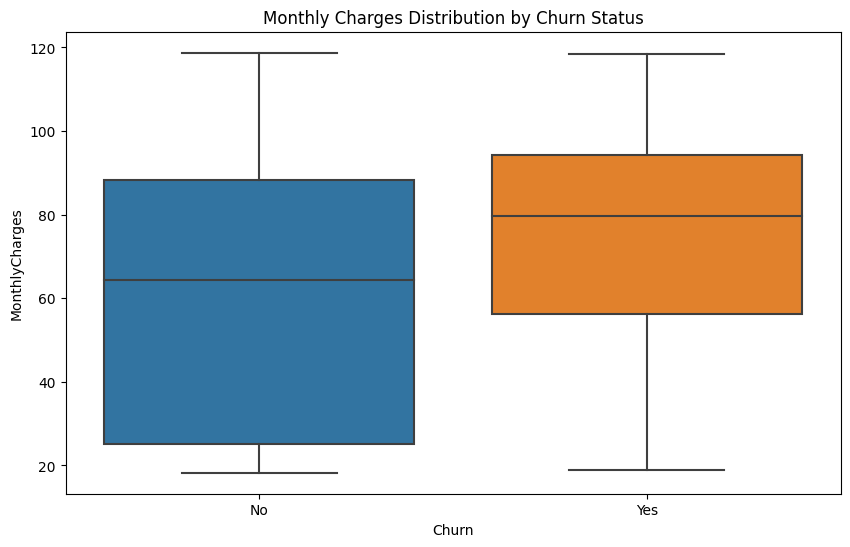

In [0]:
# Boxplot for visualizing the distribution of Monthly Charges by Churn
plt.figure(figsize=(10, 6))
sns.boxplot(x='Churn', y='MonthlyCharges', data=telco_pdf)
plt.title('Monthly Charges Distribution by Churn Status')
plt.show()

Write dataframe to delta (bronze) table

In [0]:
# Specify the desired name for the table
table_name_bronze = "telco_missing_bronze"
telco_df.write.saveAsTable(table_name_bronze) # will be stored under default catalog and schema


## Time-Travel with Delta

Now, let's explore the fascinating concept of time-travel with Delta. Here, we're delving into versioning, allowing us to read a specific or previous version of our dataset. It's a powerful feature, but in the realm of machine learning, caution is advised. 

**💡 Note:** While versioning can be crucial for reproducibility, **it may pose challenges for ML, where experiments often span longer timeframes than typical data retention periods**. The delicate balance between versioning and ML practices is a topic to tread carefully, keeping in mind potential drawbacks when utilizing previous dataset versions.

In [0]:
# Drop columns and overwrite table
to_drop_wrong = ["gender", "SeniorCitizen"]
telco_dropped_df = telco_df.drop(*to_drop_wrong)

telco_dropped_df.write.mode("overwrite").option("overwriteSchema", True).saveAsTable(table_name_bronze)

### Reverting Changes by Version

What to do, if we drop a column by mistake?

With Delta's powerful time-travel feature, we can seamlessly revert to a previous version of our dataset. Let's initiate this process by using the **'`DESCRIBE HISTORY`'** SQL command. This command provides us with a comprehensive history of changes, allowing us to pinpoint the version where '`SeniorCitizen`' was still part of our dataset. 

Let's explore and revert our unintentional omission.

In [0]:
%sql
DESCRIBE HISTORY telco_missing_bronze

version,timestamp,userId,userName,operation,operationParameters,job,notebook,clusterId,readVersion,isolationLevel,isBlindAppend,operationMetrics,userMetadata,engineInfo
1,2024-12-09T06:02:19Z,1794510796137071,labuser8052946_1733722328@vocareum.com,CREATE OR REPLACE TABLE AS SELECT,"Map(partitionBy -> [], description -> null, isManaged -> true, properties -> {}, statsOnLoad -> false)",null,List(275066564329433),1209-053231-vpdk0v78,0,WriteSerializable,false,"Map(numFiles -> 1, numOutputRows -> 7043, numOutputBytes -> 170577)",null,Databricks-Runtime/13.3.x-cpu-ml-scala2.12
0,2024-12-09T06:02:06Z,1794510796137071,labuser8052946_1733722328@vocareum.com,CREATE TABLE AS SELECT,"Map(partitionBy -> [], description -> null, isManaged -> true, properties -> {}, statsOnLoad -> false)",null,List(275066564329433),1209-053231-vpdk0v78,null,WriteSerializable,true,"Map(numFiles -> 1, numOutputRows -> 7043, numOutputBytes -> 174993)",null,Databricks-Runtime/13.3.x-cpu-ml-scala2.12


Examine the schema to validate whether columns were dropped, specifically verifying if the 'gender' & 'SeniorCitizen' columns have been removed.

In [0]:
spark.table(table_name_bronze).printSchema()

root
 |-- customerID: string (nullable = true)
 |-- Partner: string (nullable = true)
 |-- Dependents: string (nullable = true)
 |-- tenure: double (nullable = true)
 |-- phoneService: string (nullable = true)
 |-- MultipleLines: string (nullable = true)
 |-- internetService: string (nullable = true)
 |-- OnlineSecurity: string (nullable = true)
 |-- OnlineBackup: string (nullable = true)
 |-- DeviceProtection: string (nullable = true)
 |-- TechSupport: string (nullable = true)
 |-- StreamingTV: string (nullable = true)
 |-- StreamingMovies: string (nullable = true)
 |-- Contract: string (nullable = true)
 |-- PaperlessBilling: string (nullable = true)
 |-- PaymentMethod: string (nullable = true)
 |-- MonthlyCharges: double (nullable = true)
 |-- TotalCharges: double (nullable = true)
 |-- Churn: string (nullable = true)



In [0]:
%sql
DESCRIBE `telco_missing_bronze`;

col_name,data_type,comment
customerID,string,null
Partner,string,null
Dependents,string,null
tenure,double,null
phoneService,string,null
MultipleLines,string,null
internetService,string,null
OnlineSecurity,string,null
OnlineBackup,string,null
DeviceProtection,string,null



### Reverting Changes by Version
 
As we can see in the **`operation`** column in version 1, the table was overwritten, leading to the unintentional removal of columns. To rectify this, we must now perform a time-travel operation, reverting to version 0, to retrieve the table with all the original columns intact.

In [0]:
telco_df_v0 = (
  spark.read
      .option("versionAsOf", 0)
      .table(table_name_bronze)
)

telco_df_v0.printSchema()

root
 |-- customerID: string (nullable = true)
 |-- gender: string (nullable = true)
 |-- SeniorCitizen: double (nullable = true)
 |-- Partner: string (nullable = true)
 |-- Dependents: string (nullable = true)
 |-- tenure: double (nullable = true)
 |-- phoneService: string (nullable = true)
 |-- MultipleLines: string (nullable = true)
 |-- internetService: string (nullable = true)
 |-- OnlineSecurity: string (nullable = true)
 |-- OnlineBackup: string (nullable = true)
 |-- DeviceProtection: string (nullable = true)
 |-- TechSupport: string (nullable = true)
 |-- StreamingTV: string (nullable = true)
 |-- StreamingMovies: string (nullable = true)
 |-- Contract: string (nullable = true)
 |-- PaperlessBilling: string (nullable = true)
 |-- PaymentMethod: string (nullable = true)
 |-- MonthlyCharges: double (nullable = true)
 |-- TotalCharges: double (nullable = true)
 |-- Churn: string (nullable = true)




### Reverting Changes by Timestamp

You can also query based upon **`timestamp`**.  

**Note that the ability to query an older snapshot of a table (time travel) is lost after running <a href="https://docs.databricks.com/delta/delta-batch.html#deltatimetravel" target="_blank">a VACUUM command.</a>**

In [0]:
# Extract timestamp of first version (can also be set manually)
timestamp_v0 = spark.sql(f"DESCRIBE HISTORY telco_missing_bronze").orderBy("version").first().timestamp
print(timestamp_v0)

2024-12-09 06:02:06


In [0]:
(spark
        .read
        .option("timestampAsOf", timestamp_v0)
        .table("telco_missing_bronze")
        .printSchema()
)

root
 |-- customerID: string (nullable = true)
 |-- gender: string (nullable = true)
 |-- SeniorCitizen: double (nullable = true)
 |-- Partner: string (nullable = true)
 |-- Dependents: string (nullable = true)
 |-- tenure: double (nullable = true)
 |-- phoneService: string (nullable = true)
 |-- MultipleLines: string (nullable = true)
 |-- internetService: string (nullable = true)
 |-- OnlineSecurity: string (nullable = true)
 |-- OnlineBackup: string (nullable = true)
 |-- DeviceProtection: string (nullable = true)
 |-- TechSupport: string (nullable = true)
 |-- StreamingTV: string (nullable = true)
 |-- StreamingMovies: string (nullable = true)
 |-- Contract: string (nullable = true)
 |-- PaperlessBilling: string (nullable = true)
 |-- PaymentMethod: string (nullable = true)
 |-- MonthlyCharges: double (nullable = true)
 |-- TotalCharges: double (nullable = true)
 |-- Churn: string (nullable = true)



Based on original version we can specifically drop the the correct columns of disinterest and save the table again

In [0]:
to_drop = ['']
telco_dropped_df = telco_df_v0.drop(*to_drop)

telco_dropped_df.write.mode("overwrite").option("overwriteSchema", True).saveAsTable(table_name_bronze)


Version 2 is our latest and most accurate table version.

In [0]:
%sql
DESCRIBE HISTORY `telco_missing_bronze`;

version,timestamp,userId,userName,operation,operationParameters,job,notebook,clusterId,readVersion,isolationLevel,isBlindAppend,operationMetrics,userMetadata,engineInfo
2,2024-12-09T06:03:37Z,1794510796137071,labuser8052946_1733722328@vocareum.com,CREATE OR REPLACE TABLE AS SELECT,"Map(partitionBy -> [], description -> null, isManaged -> true, properties -> {}, statsOnLoad -> false)",null,List(275066564329433),1209-053231-vpdk0v78,1,WriteSerializable,false,"Map(numFiles -> 1, numOutputRows -> 7043, numOutputBytes -> 174993)",null,Databricks-Runtime/13.3.x-cpu-ml-scala2.12
1,2024-12-09T06:02:19Z,1794510796137071,labuser8052946_1733722328@vocareum.com,CREATE OR REPLACE TABLE AS SELECT,"Map(partitionBy -> [], description -> null, isManaged -> true, properties -> {}, statsOnLoad -> false)",null,List(275066564329433),1209-053231-vpdk0v78,0,WriteSerializable,false,"Map(numFiles -> 1, numOutputRows -> 7043, numOutputBytes -> 170577)",null,Databricks-Runtime/13.3.x-cpu-ml-scala2.12
0,2024-12-09T06:02:06Z,1794510796137071,labuser8052946_1733722328@vocareum.com,CREATE TABLE AS SELECT,"Map(partitionBy -> [], description -> null, isManaged -> true, properties -> {}, statsOnLoad -> false)",null,List(275066564329433),1209-053231-vpdk0v78,null,WriteSerializable,true,"Map(numFiles -> 1, numOutputRows -> 7043, numOutputBytes -> 174993)",null,Databricks-Runtime/13.3.x-cpu-ml-scala2.12



## Clean up Classroom

Run the following cell to remove lessons-specific assets created during this lesson.

In [0]:
DA.cleanup()

Resetting the learning environment:
| dropping the catalog "labuser8052946_1733722328_52n6_da"...(0 seconds)

Validating the locally installed datasets:
| listing local files...(0 seconds)
| validation completed...(0 seconds total)



## Conclusion

This demo successfully navigated the essential aspects of data management and exploration using Delta tables and Pandas. We seamlessly read and wrote data, performed time-travel operations for versioning, and computed insightful statistics for machine learning. The integrated visualizations, including correlation matrices and pair plots, provided a deeper understanding of the Telco dataset. By showcasing the power of Delta and Pandas, we've equipped ourselves with valuable tools to efficiently manage, analyze, and derive meaningful insights from our data.


&copy; 2024 Databricks, Inc. All rights reserved.<br/>
Apache, Apache Spark, Spark and the Spark logo are trademarks of the 
<a href="https://www.apache.org/">Apache Software Foundation</a>.<br/>
<br/><a href="https://databricks.com/privacy-policy">Privacy Policy</a> | 
<a href="https://databricks.com/terms-of-use">Terms of Use</a> | 
<a href="https://help.databricks.com/">Support</a>